In [ ]:
## Ejercicio 4.
#Para los datos de 'Coactivation_matrix.mat', filtre la matriz para obtener los valores > 0.2, con el nuevo 
#arreglo muestre los nodos y vértices del grafo

In [7]:
# Importar paqueterías
import numpy as np
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import scipy.io
from matplotlib import animation
from IPython.display import HTML

In [11]:
# Cargar archivos
m_path = r"C:\Users\clau\Desktop\Repositorio\Parcial III\Coactivation_matrix.mat"
m_json = scipy.io.loadmat(m_path)

m_dict = {k:v for k, v in m_json.items() if k[0] != '_'}
m_dictmat_dict = {k:v for k, v in m_json.items() if k[0] != '_'}
m_dict

{'Coactivation_matrix': array([[0.        , 0.16071429, 0.11148649, ..., 0.        , 0.05045872,
         0.1011236 ],
        [0.16071429, 0.        , 0.06825939, ..., 0.        , 0.        ,
         0.06923077],
        [0.11148649, 0.06825939, 0.        , ..., 0.03412969, 0.        ,
         0.        ],
        ...,
        [0.        , 0.        , 0.03412969, ..., 0.        , 0.        ,
         0.        ],
        [0.05045872, 0.        , 0.        , ..., 0.        , 0.        ,
         0.09777778],
        [0.1011236 , 0.06923077, 0.        , ..., 0.        , 0.09777778,
         0.        ]]),
 'Coord': array([[ 7.24363636, 37.01090909,  9.42545455],
        [ 7.98653199, 46.22222222, 15.60942761],
        [ 7.55725191, 33.83206107, 23.51145038],
        ...,
        [-4.92385787, 15.31979695, 27.73604061],
        [-6.27312775, 34.70484581, -5.09251101],
        [-4.53874539, 46.53874539,  3.06273063]])}

In [13]:
m_dict.keys()

# Definir matriz
m_adj= m_json['Coactivation_matrix']

# Fltrar-> valores >0.2
m_adj[m_adj <= 0.2] = 0

Animation size has reached 21318142 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


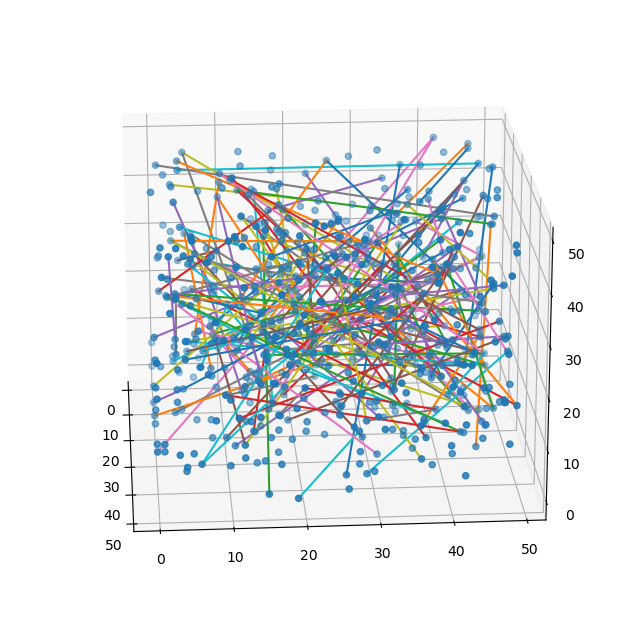

In [15]:
# Generar grafo
G = nx.from_numpy_array(m_adj)

n_nodos = G.number_of_nodes()
x = np.random.randint(0,50, size = n_nodos)
y = np.random.randint(0,50, size = n_nodos)
z = np.random.randint(0,50, size = n_nodos)

# Posiciones-> Nodos & Aristas
nodos = np.array([[i, j, k] for i, j, k in zip(x, y, z)])
edges = np.array([(nodos[u], nodos[v]) for u, v in G.edges()])

# Graficar 3D
fig= plt.figure(figsize=(8,8))
ax= fig.add_subplot(111, projection= "3d")

# Iniciación
def init():
    ax.scatter(*nodos.T)
    for edge in edges:
        ax.plot(*edge.T)
    return fig,
    
# Animación
def animate(i):
    ax.view_init(elev = 20, azim= i*4)
    return fig, 

animacion =  animation.FuncAnimation(fig, animate, init_func=init, frames=90, interval=200, blit=False)

# Renderizar
HTML(animacion.to_jshtml())